In [1]:
import mlflow
import torch
from traitlets import Set

mlflow.set_tracking_uri("http://127.0.0.1:5000")


models = {
    'pdn': torch.jit.load('model_scripted_62.pt'),
    'candidate1': mlflow.pytorch.load_model(f'models:/Dog_rec_diff_unidir/1'),
    'candidate2': mlflow.pytorch.load_model(f'models:/candidate_02/1'),
    'candidate3': mlflow.pytorch.load_model(f'models:/candidate_03/1'),
    'candidate4': mlflow.pytorch.load_model(f'models:/candidate_04/1'),
    'candidate5': mlflow.pytorch.load_model(f'models:/candidate_5/1'),
}


/home/daniel/mambaforge/envs/dogrec/lib/python3.10/site-packages/torch/serialization.py:779: UserWarning: 'torch.load' received a zip file that looks like a TorchScript archive dispatching to 'torch.jit.load' (call 'torch.jit.load' directly to silence this warning)
  warnings.warn("'torch.load' received a zip file that looks like a TorchScript archive"


In [2]:
for model in models.values():
    model.eval()

In [1]:
from torch.utils.data import DataLoader
from drecg.data.utils import FeaturesDataset

def load_datasets(root_dir= "feat_extracted/features_ext_vit_laion"):
    validation_dataset = FeaturesDataset(f'{root_dir}/validation_features.pt', with_file_paths=True)
    test_dataset = FeaturesDataset(f'{root_dir}/test_features.pt', with_file_paths=True)
    train_dataset = FeaturesDataset(f'{root_dir}/train_features.pt', with_file_paths=True)
    return validation_dataset, test_dataset, train_dataset

def load_data(root_dir = "feat_extracted/features_ext_vit_laion", batch_size=32):
    validation_dataset, test_dataset, train_dataset = load_datasets(root_dir)
    validation_dataloader = DataLoader(validation_dataset, batch_size=batch_size, shuffle=False, num_workers=4)
    test_dataloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=4)
    train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=False, num_workers=4)
    return validation_dataloader, test_dataloader, train_dataloader

In [4]:
valid_dl, test_dl, train_dl = load_data()

In [5]:
def predict_errors(dl, model, e=0.5):
    device = torch.device('cpu')
    model.to(device)
    errors = []
    total = 0
    c_matrix = {'fp': 0, 'fn': 0, 'tp': 0, 'tn': 0}
    with torch.no_grad():
        for x_batch, y_true, (files_a, files_b) in dl:
            y_pred = torch.sigmoid(model(x_batch))
            y_pred = torch.squeeze(y_pred)
            individual_error = torch.abs(y_true - y_pred).numpy()
            for (i, (error, score, label)) in enumerate(zip(individual_error, y_pred.numpy(), y_true.numpy())):
                total += 1
                if score >= e and label == 1: #true positive
                    c_matrix['tp'] += 1
                if score >= e and label == 0: #false positive
                    errors.append((error, score, label, files_a[i], files_b[i]))
                    c_matrix['fp'] += 1
                if score < e and label == 0: #true negative
                    c_matrix['tn'] += 1
                if score < e and label == 1: #false negative
                    errors.append((error, score, label, files_a[i], files_b[i]))
                    c_matrix['fn'] += 1

        return errors, (total-len(errors))/total, c_matrix

In [168]:
errors_p, acc, c_ma = predict_errors(valid_dl, models['pdn'])

In [157]:
acc

0.9512195121951219

In [169]:
acc

0.9512195121951219

In [170]:
(c_ma['tp']+c_ma['tn'])/(c_ma['tp']+c_ma['tn']+c_ma['fn']+c_ma['fp']) == acc

True

In [94]:
import matplotlib.pyplot as plt
import PIL.Image as Image


def show_errors(errors):
    my_list = []
    for (error, score, label, file_a, file_b) in errors:
        my_list.append((error, score, label, Image.open(file_a), Image.open(file_b)))
    my_list = sorted(my_list, key=lambda x: x[0], reverse=True)

    # set up the figure with the appropriate number of rows and columns
    num_pairs = len(my_list)
    num_cols = 3  # we'll always have 3 elements per tuple
    num_rows = num_pairs

    # set the figure size to be a little larger than the default
    fig = plt.figure(figsize=(20, 5 * num_rows))
    # iterate over the list of tuples and plot each pair in a separate row
    for i, (error, score, label, img1, img2) in enumerate(my_list):
        # add a subplot for this pair of images
        ax = fig.add_subplot(num_rows, num_cols, i * num_cols + 1)
        # plot the first image
        ax.imshow(img1)
        # turn off axis labels for readability
        ax.axis('off')

        # add another subplot for the second image
        ax = fig.add_subplot(num_rows, num_cols, i * num_cols + 2)
        # plot the second image
        ax.imshow(img2)
        # turn off axis labels for readability
        ax.axis('off')

        # add another subplot for the score label
        ax = fig.add_subplot(num_rows, num_cols, i * num_cols + 3)
        # add the score as a text label
        ax.text(0.5, 0.5, f'Error: {error}\nScore: {score}\nTrue Label: {label}', fontsize=12, ha='left', va='center')
        # turn off axis labels for readability
        ax.axis('off')
    # adjust the spacing between subplots for readability
    fig.subplots_adjust(wspace=0.05, hspace=0.1)

    # show the final figure
    plt.show()

In [6]:
def find_and_show_errors(model, dl, thr=0.5):
    errors, acc, c_matrix = predict_errors(dl, model, e=thr)
    print(c_matrix)
    print(f'Accuracy: {acc}')
    print(f'Recall: {c_matrix["tp"]/(c_matrix["tp"]+c_matrix["fn"])}')
    print(f'Precision: {c_matrix["tp"]/(c_matrix["tp"]+c_matrix["fp"])}')

    # show_errors(errors)

In [11]:
find_and_show_errors(models['pdn'], train_dl, thr=0.5)

{'fp': 0, 'fn': 0, 'tp': 1943, 'tn': 1943}
Accuracy: 1.0
Recall: 1.0
Precision: 1.0


#### Errors Summary
 * The models seem to get confused by clothes and accessories which maybe get interpreted as different coat patterns in the dogs (harnesses get confused by chest coat patterns)
* There are also examples of cases when is very difficult to identify the match even for a human
* It seems the models suffers form overfitting of the training dataset (very high accuracy), but despite that those models generalize apparently well but no so well

#### Actions to take
* Identify and remove outliers from datasets
* Evaluate again without outliers (test and valid)
* Identify contamination in the datasets
* Create 5% of same photo pairs and evaluate effect in validation

In [12]:
validation_dataset, test_dataset, train_dataset = load_datasets()

In [13]:
len(validation_dataset), len(train_dataset), len(test_dataset)

(164, 3886, 346)

In [17]:
a = set()

In [18]:
a.add('2')

In [21]:
a

{'2'}

In [29]:
len(validation_dataset[0])

3

In [132]:
import numpy as np
def to_np_arr(ds):
    items_set = []
    for ((x_1, x_2),y, files) in ds:
        items_set.append(x_1.numpy())
        items_set.append(x_2.numpy())
    return np.stack(items_set)


def to_ord_list(ds):
    ord_list = []
    for ((_x_1, _x_2),y, files) in ds:
        ord_list.append(files[0])
        ord_list.append(files[1])
    return ord_list

In [82]:
validation_dataset, test_dataset, train_dataset = load_datasets()

In [265]:
train_set = to_np_arr(train_dataset)
test_set = to_np_arr(test_dataset)
valid_set = to_np_arr(validation_dataset)

In [134]:
train_list = to_ord_list(train_dataset)
test_list = to_ord_list(test_dataset)
valid_list = to_ord_list(validation_dataset)

In [298]:
from tqdm.auto import tqdm
bar = tqdm(range(len(valid_set)*len(valid_set)))
sims = []
for i_val, vec_val in enumerate(valid_set):
    for i_train, vec_train in enumerate(valid_set):
        bar.update(1)
        if i_val != i_train:
            norm = np.linalg.norm(vec_val - vec_train)
            if norm < 20.0:
                sims.append((i_val, i_train, norm))

  0%|          | 0/107584 [00:00<?, ?it/s]

In [242]:
ss = [(x1, x2, score) for (x1, x2, score) in sims if score < 11]

In [300]:
len(sims)

24

In [302]:
24/len(valid_set)

0.07317073170731707

In [292]:
img_0, img_1 = valid_list[107], valid_list[104]

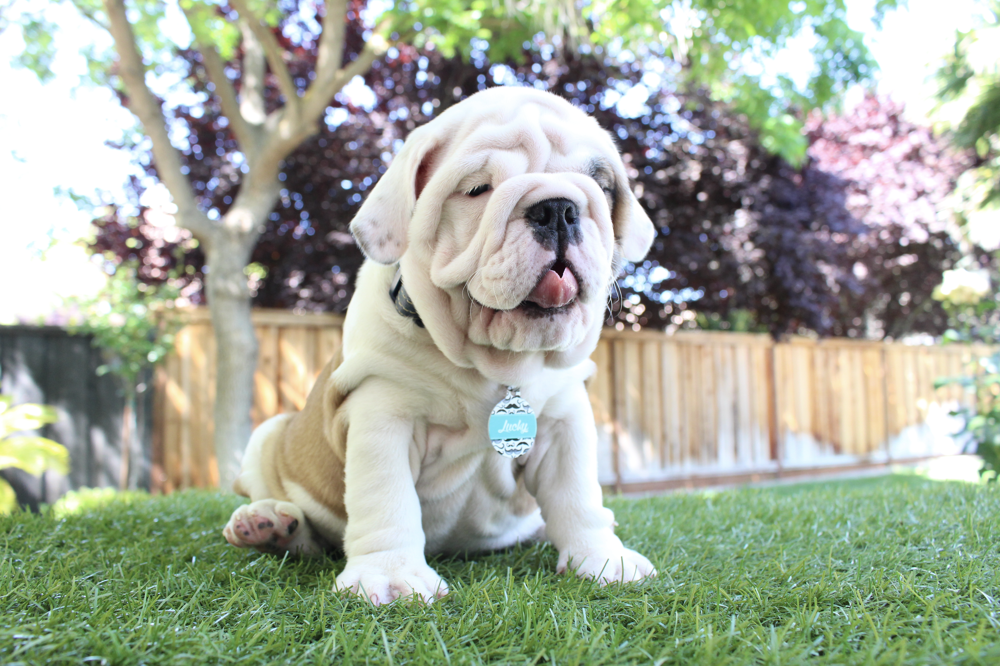

In [293]:
import PIL.Image as Image
Image.open(img_0)

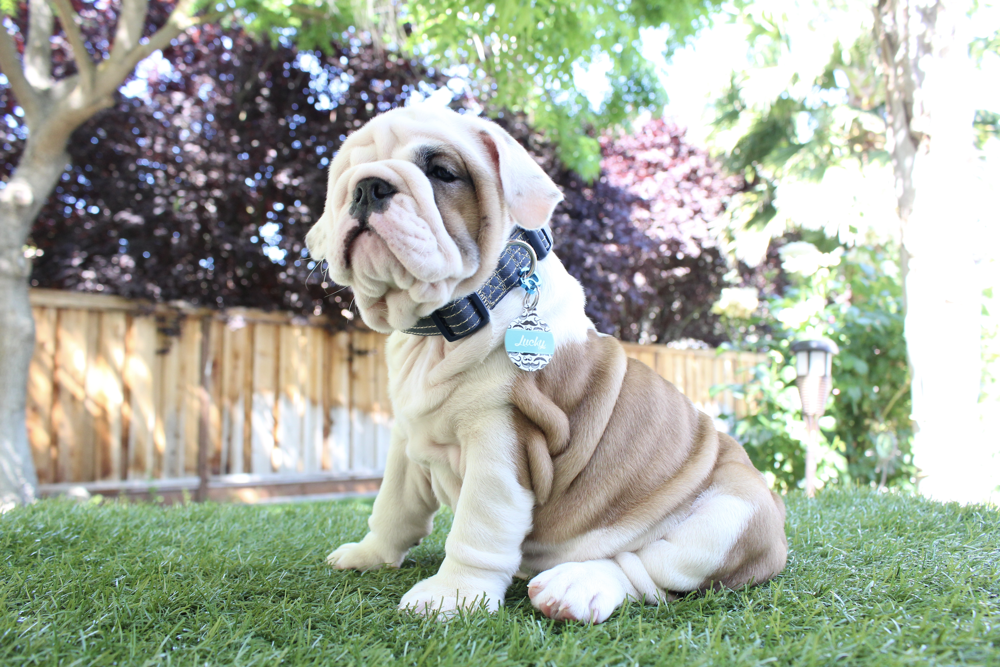

In [294]:
Image.open(img_1)

In [2]:
import numpy as np
import pandas as pd
def convert_for_analysis(ds, split):
    deltas = {
        'train': 0.0,
        'valid': 0.015,
        'test': 0.03
    }
    items_list = []
    for ((x_1, x_2),y, files) in ds:
        distance = np.linalg.norm(x_1.numpy() - x_2.numpy())
        items_list.append((y.item()+deltas[split], distance, split, files[0], files[1]))
    return items_list

def convert_for_analysis_df(train_ds, valid_ds, test_ds):
    all_data = []
    all_data.extend(convert_for_analysis(train_ds, 'train'))
    all_data.extend(convert_for_analysis(valid_ds, 'valid'))
    all_data.extend(convert_for_analysis(test_ds, 'test'))
    return pd.DataFrame(all_data)

In [151]:
validation_dataset, test_dataset, train_dataset = load_datasets()
df = convert_for_analysis_df(train_dataset, validation_dataset, test_dataset)

In [147]:
df[(df[2] == 'valid') | (df[2] == 'test')]

,0,1,2
3886,1.0333,28.770407,valid
3887,1.0333,33.700340,valid
3888,1.0333,31.593225,valid
3889,1.0333,37.461571,valid
3890,1.0333,30.297255,valid
...,...,...,...
4391,0.0666,37.003750,test
4392,0.0666,33.960625,test
4393,0.0666,40.855686,test
4394,0.0666,34.863426,test


In [12]:
import matplotlib.pyplot as plt
import numpy as np

def plot_distribution(all_data, second_data=None):
    #columns = ['y', 'distance', 'split', 'img_a', 'img_b']
    plt.style.use('_mpl-gallery')
    # i = np.random.choice(np.arange(3500, 4395), size=890, replace=False)
    # data = all_data.iloc[i]
    data = all_data
    # Create a dictionary to map categorical values to colors
    colors = {'train': 'red', 'valid': 'green', 'test': 'blue'}

    # Create a list of colors for each data point
    color_list = [colors[t] for t in data.iloc[:, 2]]
    color_list2 = [colors[t] for t in second_data.iloc[:, 2]]
    fig, ax = plt.subplots(figsize=(8, 7))

    ax.scatter(data.iloc[:, 0], data.iloc[:, 1], c=color_list)

    if second_data is not None:
        ax.scatter(second_data.iloc[:, 0], second_data.iloc[:, 1], c=color_list2, marker='v')

    ax.set_xticks([0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1.0,1.1])
    ax.set_xticklabels([0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1.0,1.1], fontsize=8)

    ax.set_yticks([0,10, 20, 30, 40, 50, 60])
    ax.set_yticklabels([0,10, 20, 30, 40, 50, 60], fontsize=12)

    plt.show()

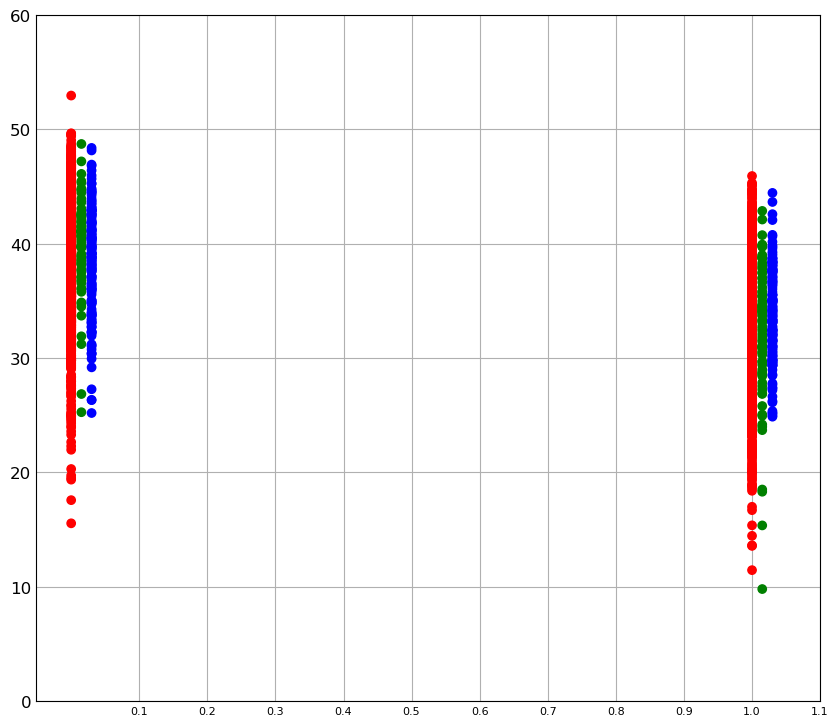

In [222]:
plot_distribution(df)

Median (different): 40.69317436218262
Median (same): 33.53215408325195


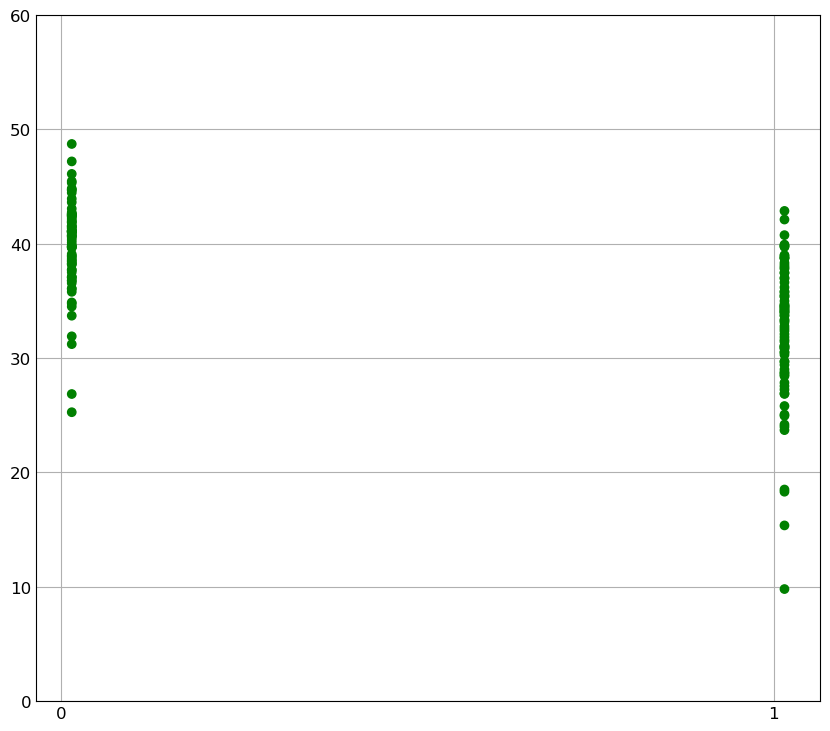

In [168]:
valid_df = df[(df[2] == 'valid')]
print(f'Median (different): {valid_df[valid_df[0] == 0.015][1].quantile()}')
print(f'Median (same): {valid_df[valid_df[0] == 1.015][1].quantile()}')
plot_distribution(valid_df)

Median (different): 38.86936569213867
Median (same): 33.65034103393555


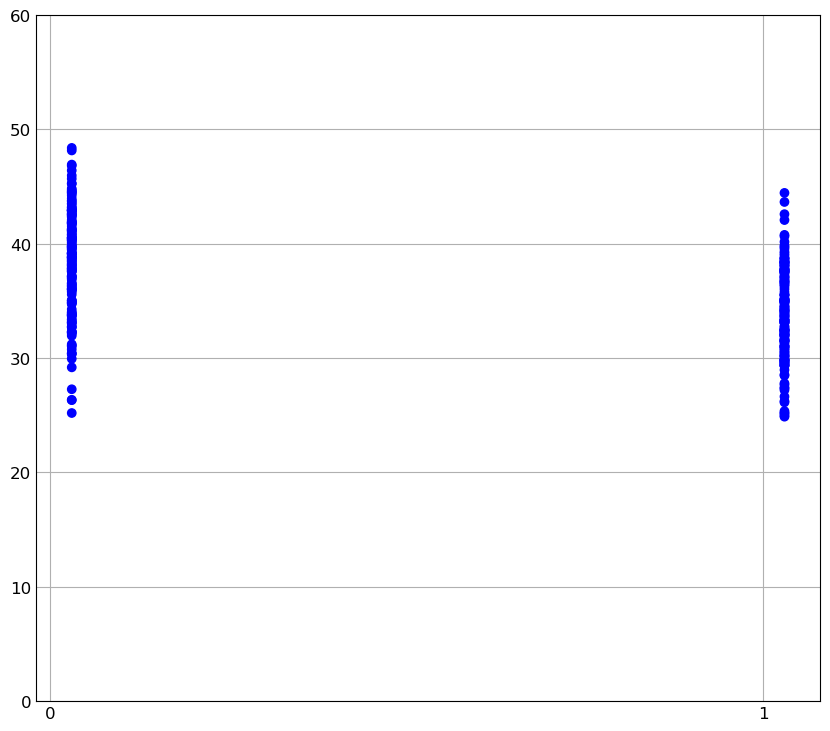

In [170]:
test_df = df[(df[2] == 'test')]
print(f'Median (different): {test_df[test_df[0] == 0.03][1].quantile()}')
print(f'Median (same): {test_df[test_df[0] == 1.03][1].quantile()}')
plot_distribution(test_df)

In [140]:
df[(df[2] == 'valid') & (df[0] == 1)][1].quantile(0.2)

25.141987991333007

In [96]:
def calculate_quantiles(df, y):
    quantiles = np.linspace(0.01, 0.99)
    results = []
    train_df = df[(df['split'] == 'train')]
    valid_df = df[(df['split'] == 'valid')]
    test_df =  df[(df['split'] == 'test')]
    for q in quantiles:
        results.append((q, train_df[train_df['y'] == y]['distance'].quantile(q), 'train'))
        results.append((q, valid_df[valid_df['y'] == y+0.015]['distance'].quantile(q), 'valid'))
        results.append((q, test_df[test_df['y'] == y+0.03]['distance'].quantile(q), 'test'))
    return pd.DataFrame(results)


In [3]:
def calculate_high_low_quantiles(dataframe, low=0.01, high=0.99):
    high_quantile = dataframe[1].quantile(high)
    low_quantile = dataframe[1].quantile(low)
    return low_quantile, high_quantile

def filter_items_by_value(dataframe, value, higher_than=True):
    if higher_than:
        return dataframe[dataframe[1] > value]
    else:
        return dataframe[dataframe[1] <= value]


def extract_outliers(dataset, split, y, low=0.01, high=0.99):
    deltas = {
        'train': 0.0,
        'valid': 0.015,
        'test': 0.03
    }
    dataframe = pd.DataFrame(convert_for_analysis(dataset, split))
    dataframe= dataframe[dataframe[0] == y+deltas[split]]
    low_quantile, high_quantile = calculate_high_low_quantiles(dataframe, low, high)
    columns = ['y', 'distance', 'split', 'img_a', 'img_b']
    outliers_high = filter_items_by_value(dataframe, high_quantile)
    outliers_low = filter_items_by_value(dataframe, low_quantile, higher_than=False)
    outliers_high.columns = columns
    outliers_low.columns = columns
    return outliers_high, outliers_low

In [4]:
validation_dataset, test_dataset, train_dataset = load_datasets()

In [5]:
validation_dataset[0]

((tensor([ 0.1095,  0.9876, -0.8387,  ..., -0.2940, -1.3010,  0.1322]),
  tensor([ 0.9024,  1.1764, -1.1444,  ...,  0.3373, -1.3307, -1.1964])),
 tensor(1),
 ('/home/daniel/data_dogs/validation/same/1400a.png',
  '/home/daniel/data_dogs/validation/same/1400b.png'))

In [6]:
outliers_h, outliers_l = extract_outliers(validation_dataset, 'valid', 0, low=0.03, high=0.95)


In [7]:
outliers_h

,y,distance,split,img_a,img_b
89,0.015,46.114128,valid,/home/daniel/data_dogs/validation/different/14...,/home/daniel/data_dogs/validation/different/14...
127,0.015,47.207394,valid,/home/daniel/data_dogs/validation/different/16...,/home/daniel/data_dogs/validation/different/16...
130,0.015,45.478004,valid,/home/daniel/data_dogs/validation/different/16...,/home/daniel/data_dogs/validation/different/16...
135,0.015,45.337051,valid,/home/daniel/data_dogs/validation/different/17...,/home/daniel/data_dogs/validation/different/17...
137,0.015,48.732395,valid,/home/daniel/data_dogs/validation/different/17...,/home/daniel/data_dogs/validation/different/17...


In [9]:
valid_df = pd.DataFrame(convert_for_analysis(validation_dataset, 'valid'))
valid_df

,0,1,2,3,4
0,1.015,28.770407,valid,/home/daniel/data_dogs/validation/same/1400a.png,/home/daniel/data_dogs/validation/same/1400b.png
1,1.015,33.700340,valid,/home/daniel/data_dogs/validation/same/1401a.png,/home/daniel/data_dogs/validation/same/1401b.png
2,1.015,31.593225,valid,/home/daniel/data_dogs/validation/same/1402a.png,/home/daniel/data_dogs/validation/same/1402b.png
3,1.015,37.461571,valid,/home/daniel/data_dogs/validation/same/1403a.png,/home/daniel/data_dogs/validation/same/1403b.png
4,1.015,30.297255,valid,/home/daniel/data_dogs/validation/same/1404a.png,/home/daniel/data_dogs/validation/same/1404b.png
...,...,...,...,...,...
159,0.015,40.791740,valid,/home/daniel/data_dogs/validation/different/19...,/home/daniel/data_dogs/validation/different/19...
160,0.015,36.083782,valid,/home/daniel/data_dogs/validation/different/19...,/home/daniel/data_dogs/validation/different/19...
161,0.015,38.436222,valid,/home/daniel/data_dogs/validation/different/19...,/home/daniel/data_dogs/validation/different/19...
162,0.015,34.510220,valid,/home/daniel/data_dogs/validation/different/19...,/home/daniel/data_dogs/validation/different/19...


In [14]:
import matplotlib.pyplot as plt
def plot_histograms(dataframe0, dataframe1):
    fig, ax = plt.subplots(1, 2, figsize=(10, 5))
    ax[0].hist(dataframe0[1], bins=100)
    ax[1].hist(dataframe1[1], bins=100)
    plt.show()


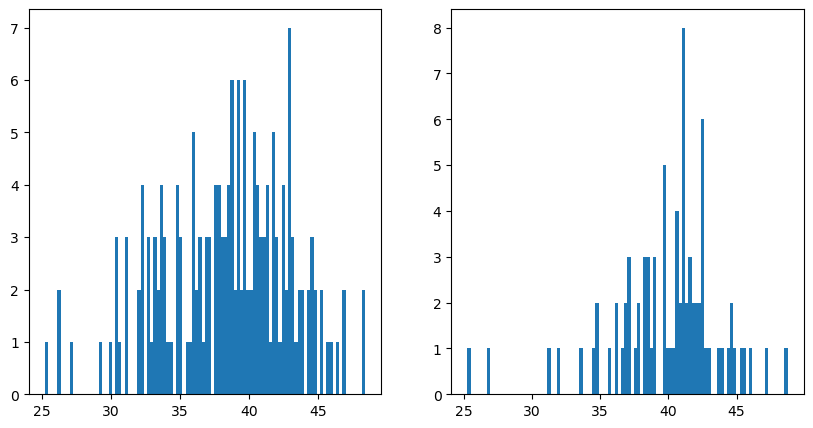

In [15]:
test_df = pd.DataFrame(convert_for_analysis(test_dataset, 'test'))
plot_histograms(test_df[test_df[0] == 0.03], valid_df[valid_df[0] == 0.015])

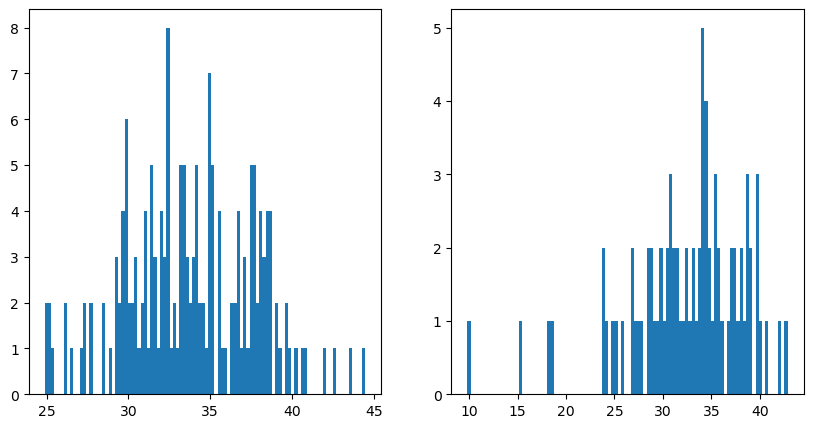

In [18]:
plot_histograms(test_df[test_df[0] == 1.03], valid_df[valid_df[0] == 1.015])

(23.718414497375488, 42.57117635726929)

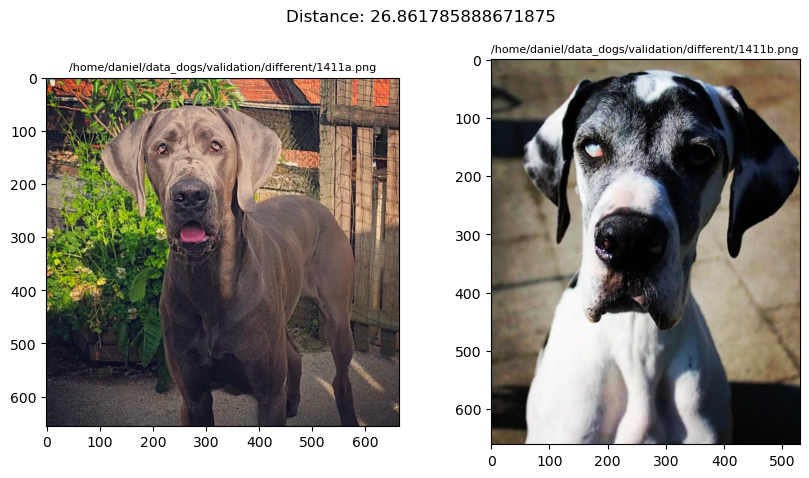

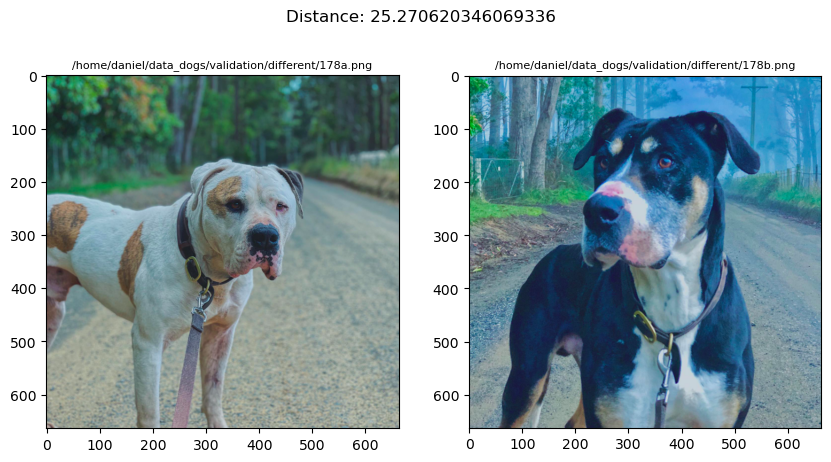

In [68]:
display(calculate_high_low_quantiles(valid_df[valid_df[0] == 1.015], low=0.05, high=0.995))
outliers_h, outliers_l = extract_outliers(validation_dataset, 'valid', 0, low=0.015, high=0.99)
plot_images_pairs(outliers_l)

In [72]:
##Outliers to remove
# 5% low y=1 (valid), 1% low y=0 (test), 99 high both and train y=1
valid_1_high, valid_1_low = extract_outliers(validation_dataset, 'valid', 1, low=0.05, high=0.99)
_, test_0_low = extract_outliers(test_dataset, 'test', 0, low=0.01, high=0.99)
train_1_high, _ = extract_outliers(train_dataset, 'train', 1, low=0.01, high=0.99)

validation_to_remove = pd.concat([valid_1_high, valid_1_low])
test_to_remove = test_0_low
train_to_remove = train_1_high

In [78]:
import os
def remove_images_in_disk(df):
    for _, row in df.iterrows():
        os.remove(row['img_a'])
        os.remove(row['img_b'])

In [81]:

def remove_items_in_df_by_idxs(df, to_remove_df):
    return df.drop(to_remove_df.index)

In [86]:

valid_df = remove_items_in_df_by_idxs(valid_df, validation_to_remove)
test_df = remove_items_in_df_by_idxs(test_df, test_to_remove)
train_df = remove_items_in_df_by_idxs(train_df, train_to_remove)

In [79]:
remove_images_in_disk(validation_to_remove)
remove_images_in_disk(test_to_remove)
remove_images_in_disk(train_to_remove)


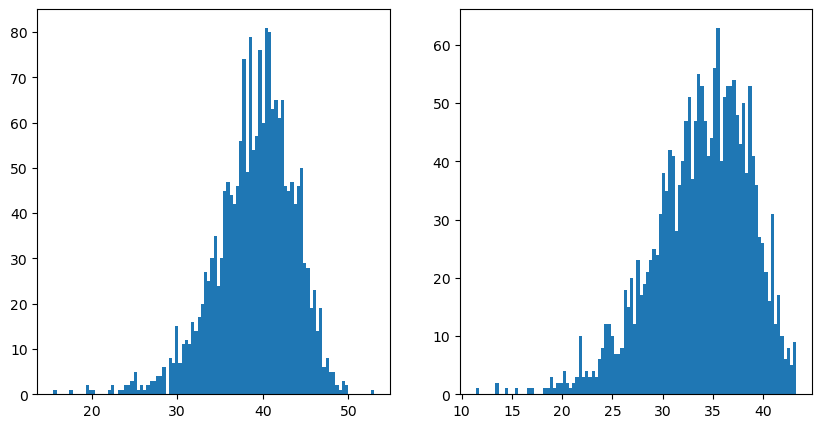

In [87]:
# train_df = pd.DataFrame(convert_for_analysis(train_dataset, 'train'))
plot_histograms(train_df[train_df[0] == 0.0], train_df[train_df[0] == 1.0])

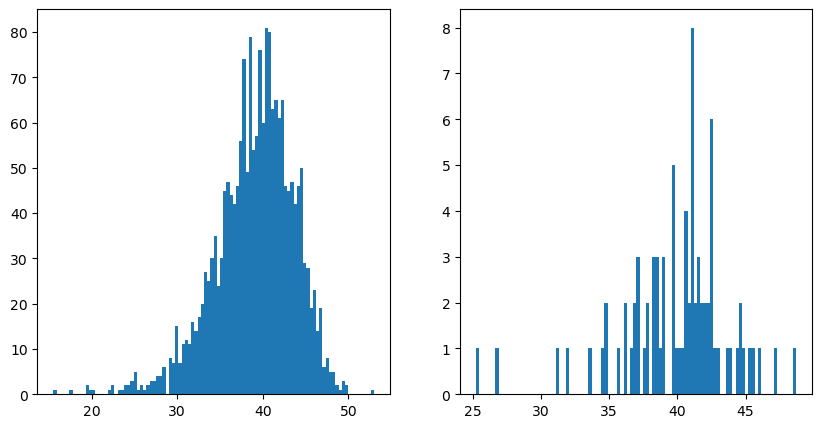

In [88]:
#compare train and validation
plot_histograms(train_df[train_df[0] == 0.0], valid_df[valid_df[0] == 0.015])

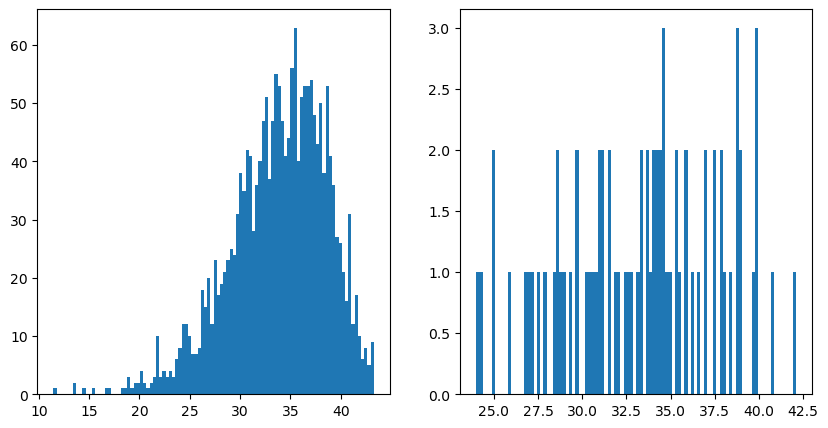

In [89]:
plot_histograms(train_df[train_df[0] == 1.0], valid_df[valid_df[0] == 1.015])

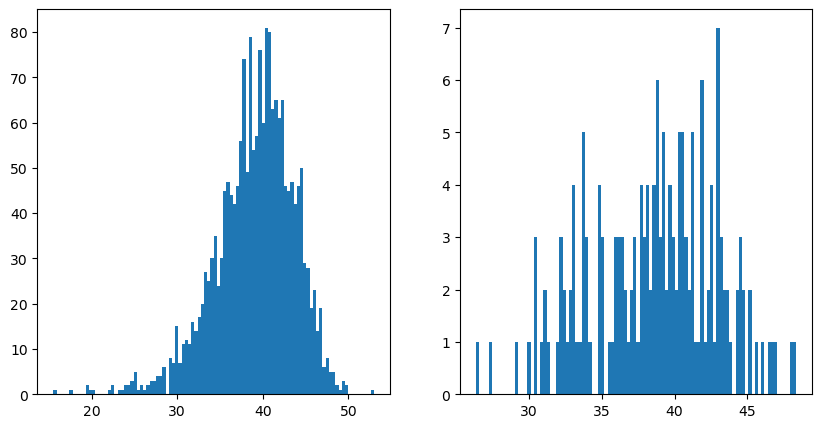

In [90]:
#compare train and test
plot_histograms(train_df[train_df[0] == 0.0], test_df[test_df[0] == 0.03])

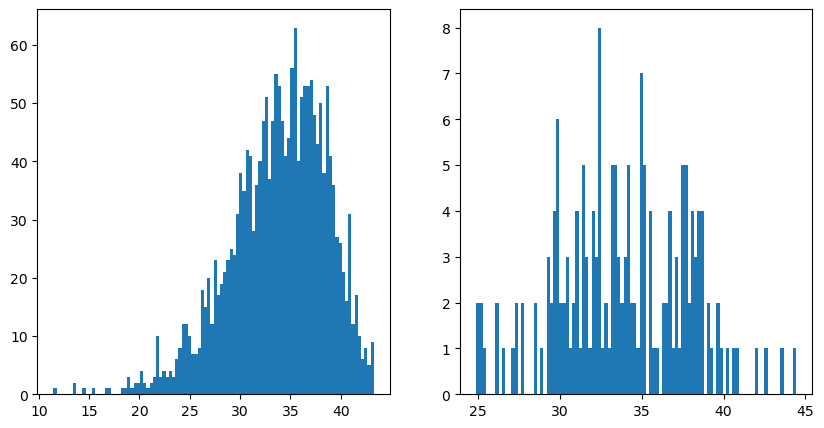

In [91]:
plot_histograms(train_df[train_df[0] == 1.0], test_df[test_df[0] == 1.03])

In [26]:
import matplotlib.pyplot as plt
def plot_images_pairs(outliers_dataframe):
    for i in range(len(outliers_dataframe)):
        img_path_a = outliers_dataframe.iloc[i]['img_a']
        img_path_b = outliers_dataframe.iloc[i]['img_b']
        distance = outliers_dataframe.iloc[i]['distance']
        img_a = plt.imread(img_path_a)
        img_b = plt.imread(img_path_b)
        fig, ax = plt.subplots(1, 2, figsize=(10, 5))
        ax[0].imshow(img_a)
        ax[1].imshow(img_b)
        ax[0].set_title(f'{img_path_a}')
        ax[1].set_title(f'{img_path_b}')
        #set title font size to smaller size
        ax[0].title.set_fontsize(8)
        ax[1].title.set_fontsize(8)
        plt.suptitle(f'Distance: {distance}')
        plt.show()


In [37]:
outliers_h, outliers_l = extract_outliers(train_dataset, 'train', 0, low=0.005, high=0.99)

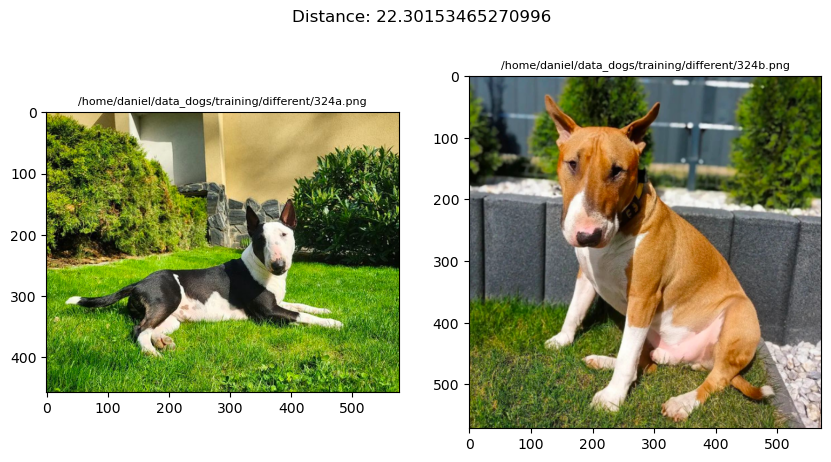

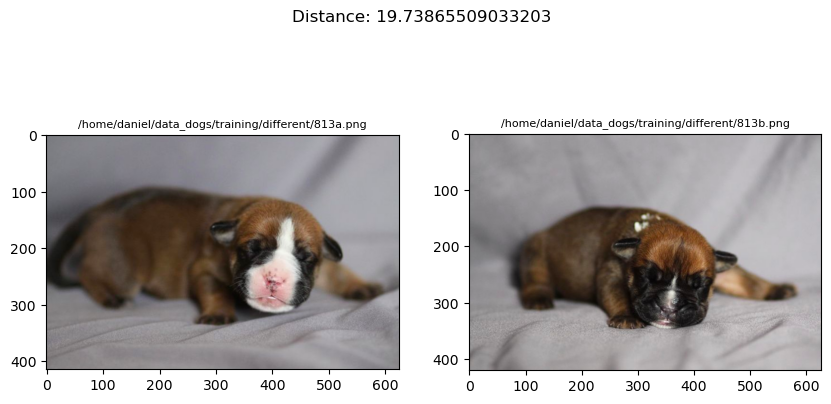

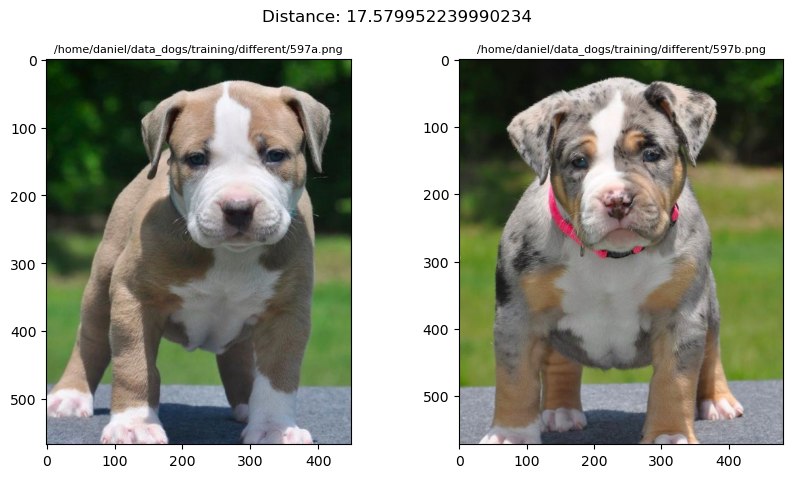

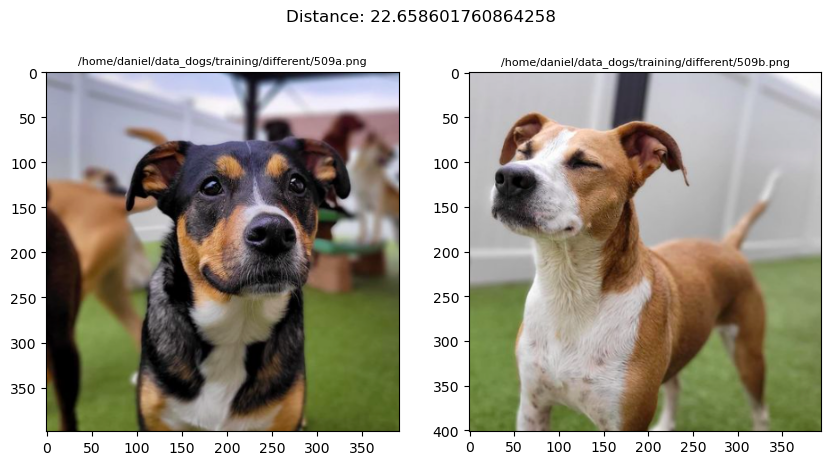

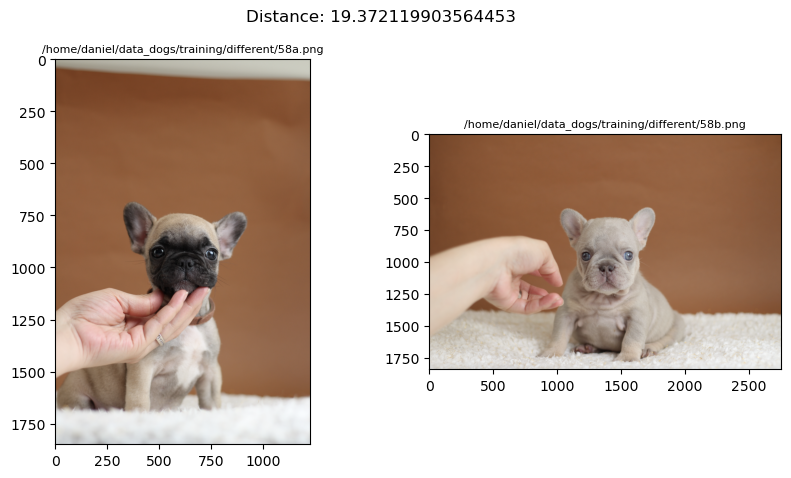

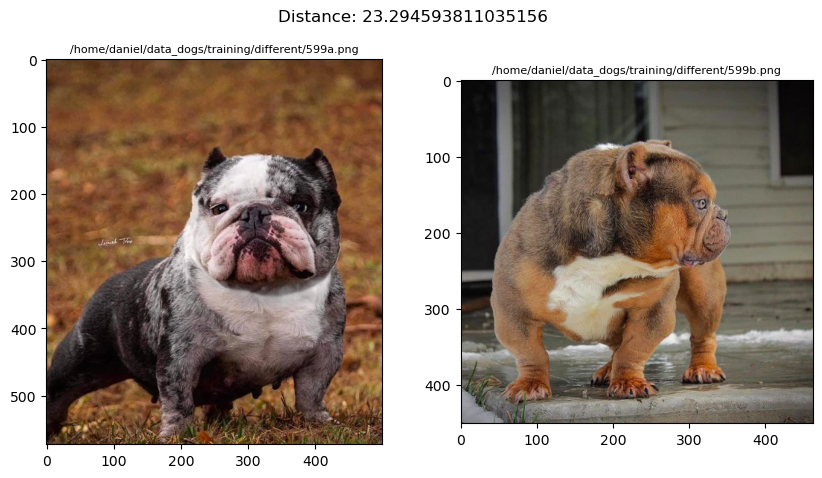

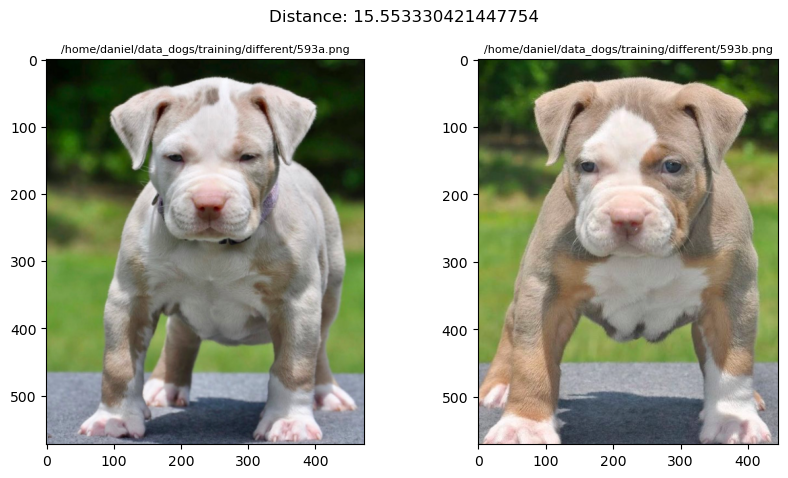

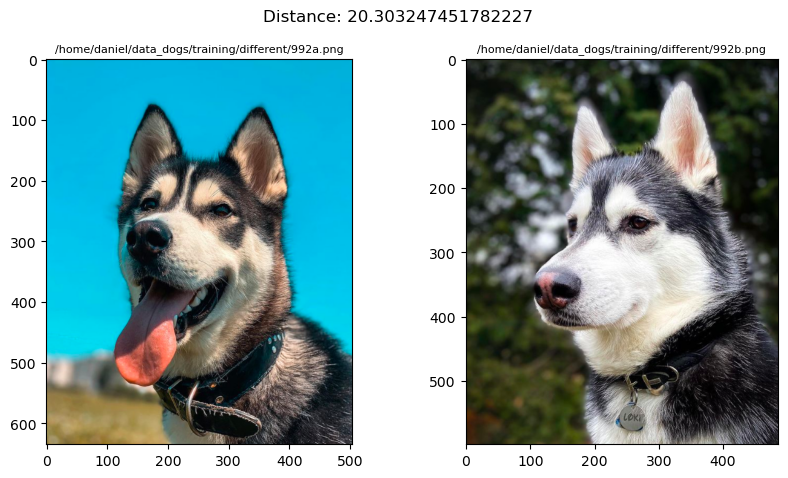

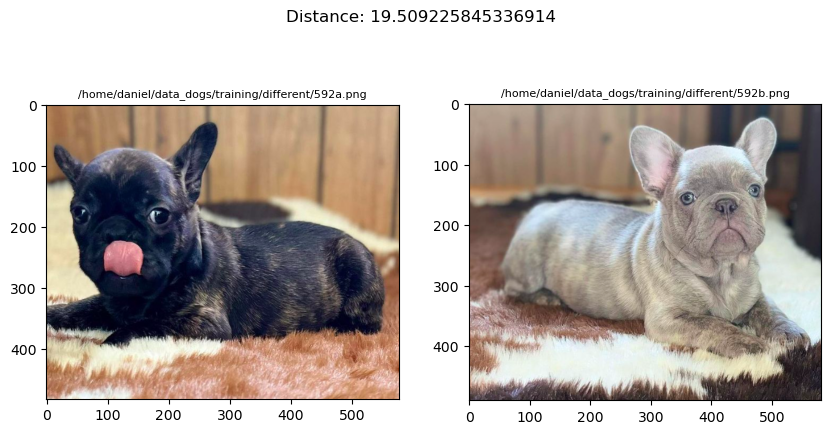

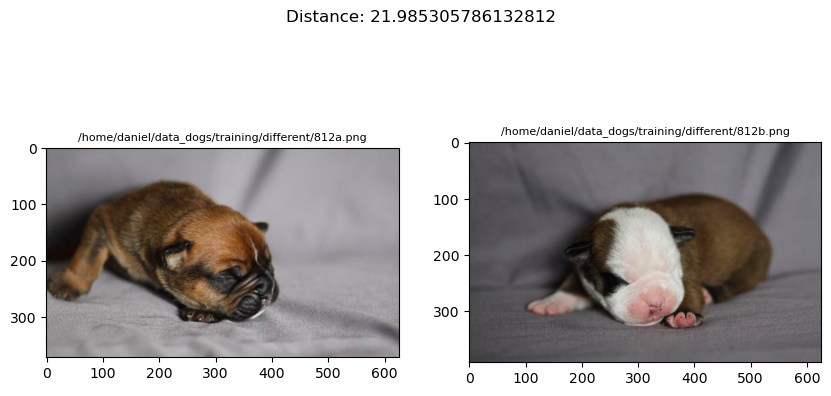

In [38]:
plot_images_pairs(outliers_l)

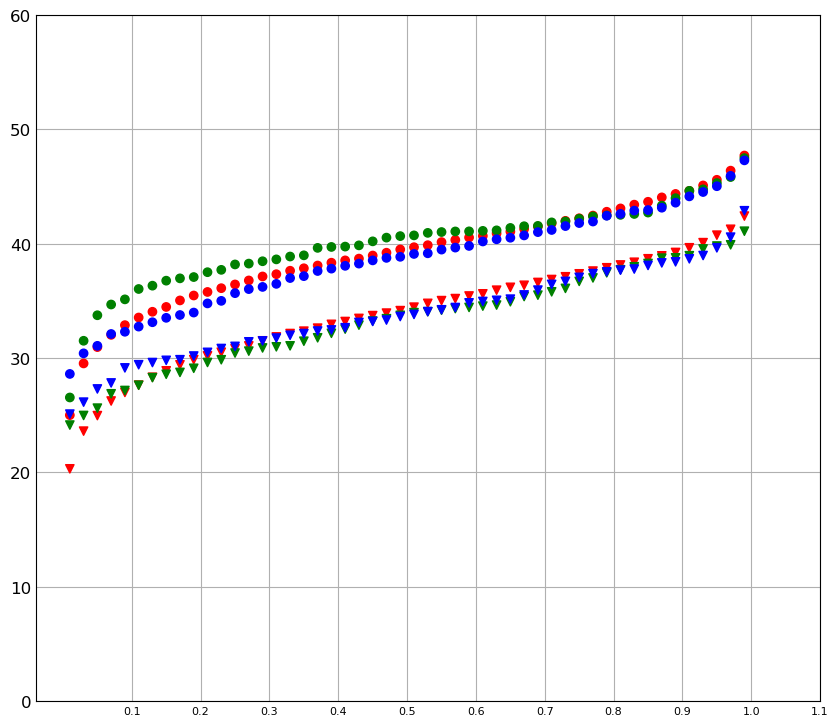

In [104]:
df = pd.concat([valid_df, test_df, train_df])
columns = ['y', 'distance', 'split', 'img_a', 'img_b']
df.columns = columns
plot_distribution(calculate_quantiles(df, 0), calculate_quantiles(df, 1))
colors = {
    'train': 'red',
    'valid': 'green',
    'test': 'blue'}

In [209]:
from sklearn.model_selection import train_test_split
merged = pd.concat([valid_df, test_df])
merged.columns = columns

merged['y_true'] = merged['y'].apply(lambda x: 1 if x >= 1 else 0)

merged_1 = merged[merged['y_true'] == 1].copy()
merged_0 = merged[merged['y_true'] == 0].copy()

merged_1['distance_binned'] = np.digitize(merged_1['distance'], [20, 25, 30, 35, 40, 45])
merged_0['distance_binned'] = np.digitize(merged_0['distance'], [25, 32, 35, 37, 40, 43, 47, 50])

valid_1, test_1 = train_test_split(merged_1, test_size=0.5, stratify=merged_1['distance_binned'])
valid_0, test_0 = train_test_split(merged_0, test_size=0.5, stratify=merged_0['distance_binned'])

new_valid_df = pd.concat([valid_1, valid_0])
new_valid_df['split'] = 'valid'
new_test_df = pd.concat([test_1, test_0])
new_test_df['split'] = 'test'

<AxesSubplot: >

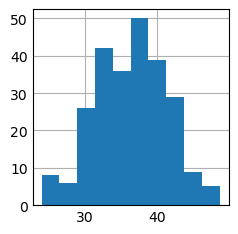

In [211]:
new_valid_df['distance'].hist()

In [213]:
new_test_df

,y,distance,split,img_a,img_b,y_true,distance_binned
53,1.030,31.689827,test,/home/daniel/data_dogs/testing/same/14a.png,/home/daniel/data_dogs/testing/same/14b.png,1,3
64,1.030,31.374294,test,/home/daniel/data_dogs/testing/same/15a.png,/home/daniel/data_dogs/testing/same/15b.png,1,3
22,1.015,37.029083,test,/home/daniel/data_dogs/validation/same/1422a.png,/home/daniel/data_dogs/validation/same/1422b.png,1,4
67,1.015,34.609039,test,/home/daniel/data_dogs/validation/same/186a.png,/home/daniel/data_dogs/validation/same/186b.png,1,3
66,1.015,32.384254,test,/home/daniel/data_dogs/validation/same/185a.png,/home/daniel/data_dogs/validation/same/185b.png,1,3
...,...,...,...,...,...,...,...
84,0.015,40.674271,test,/home/daniel/data_dogs/validation/different/14...,/home/daniel/data_dogs/validation/different/14...,0,5
270,0.030,40.450245,test,/home/daniel/data_dogs/testing/different/31a.png,/home/daniel/data_dogs/testing/different/31b.png,0,5
96,0.015,37.074402,test,/home/daniel/data_dogs/validation/different/14...,/home/daniel/data_dogs/validation/different/14...,0,4
147,0.015,39.099228,test,/home/daniel/data_dogs/validation/different/18...,/home/daniel/data_dogs/validation/different/18...,0,4


In [216]:
#Persist both new datasets to disk
new_valid_df.to_csv('new_valid.csv', index=False)
new_test_df.to_csv('new_test.csv', index=False)

In [2]:
import pandas as pd
#read both new datasets from disk
new_test = pd.read_csv('new_test.csv')
new_valid = pd.read_csv('new_valid.csv')


In [22]:
#Set column y to 1.015 when y >= 1.0
# new_valid.loc[new_valid['y_true'] == 0, 'y'] = 0.03
# new_test.loc[new_test['y_true'] == 0, 'y'] = 0
new_test.loc[new_test['y_true'] == 1, 'y'] = 1

In [38]:
new_valid

,y,distance,split,img_a,img_b,y_true,distance_binned
0,1.015,30.683975,valid,/home/daniel/data_dogs/testing/same/122a.png,/home/daniel/data_dogs/testing/same/122b.png,1,3
1,1.015,44.452220,valid,/home/daniel/data_dogs/testing/same/19a.png,/home/daniel/data_dogs/testing/same/19b.png,1,5
2,1.015,37.945095,valid,/home/daniel/data_dogs/validation/same/1427a.png,/home/daniel/data_dogs/validation/same/1427b.png,1,4
3,1.015,38.469852,valid,/home/daniel/data_dogs/testing/same/56a.png,/home/daniel/data_dogs/testing/same/56b.png,1,4
4,1.015,34.108654,valid,/home/daniel/data_dogs/testing/same/145a.png,/home/daniel/data_dogs/testing/same/145b.png,1,3
...,...,...,...,...,...,...,...
245,0.030,36.297200,valid,/home/daniel/data_dogs/testing/different/64a.png,/home/daniel/data_dogs/testing/different/64b.png,0,3
246,0.030,33.648660,valid,/home/daniel/data_dogs/testing/different/80a.png,/home/daniel/data_dogs/testing/different/80b.png,0,2
247,0.030,39.660835,valid,/home/daniel/data_dogs/validation/different/19...,/home/daniel/data_dogs/validation/different/19...,0,4
248,0.030,45.687336,valid,/home/daniel/data_dogs/testing/different/26a.png,/home/daniel/data_dogs/testing/different/26b.png,0,6


In [26]:
from pathlib import Path
f = '/home/daniel/data_dogs/validation/same/1422a.png'
fp = Path(f)
fp.name

'1422a.png'

In [35]:
from tqdm.auto import tqdm
import shutil

new_root = Path('/home/daniel/data_dog_new/')
new_root.mkdir(exist_ok=True)
new_valid_root = new_root / 'validation'
new_valid_root.mkdir(exist_ok=True)
new_test_root = new_root / 'testing'
new_test_root.mkdir(exist_ok=True)

def copy_images(df, split):
    split_dir = new_valid_root if split == 'valid' else new_test_root
    (split_dir / 'same').mkdir(exist_ok=True)
    (split_dir / 'different').mkdir(exist_ok=True)
    for i in range(len(df)):
        img_path_a = df.iloc[i]['img_a']
        img_path_b = df.iloc[i]['img_b']
        same = df.iloc[i]['y_true'] == 1
        new_file_path = split_dir / ('same' if same else 'different')
        img_a = Path(img_path_a)
        img_b = Path(img_path_b)

        prefix = '22' if img_a.parent.parent.name == 'testing' else ''

        new_file_path_a = new_file_path / f'{prefix}{img_a.name}'
        new_file_path_b = new_file_path / f'{prefix}{img_b.name}'

        shutil.copy(img_path_a, new_file_path_a)
        shutil.copy(img_path_b, new_file_path_b)



In [34]:
copy_images(new_valid, 'valid')

  0%|          | 0/250 [00:00<?, ?it/s]

In [36]:
copy_images(new_test, 'test')

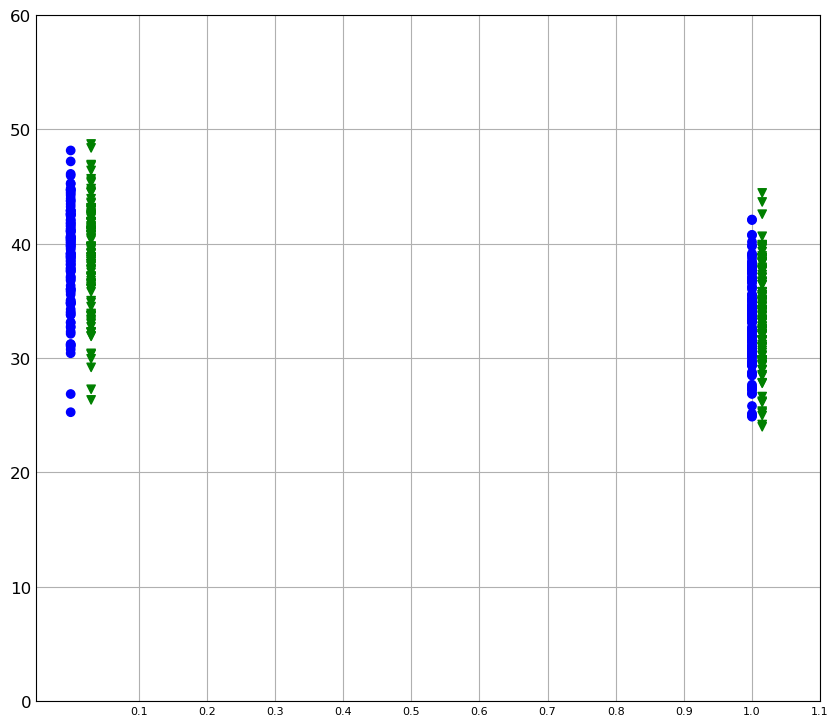

In [24]:
plot_distribution(new_test, new_valid)

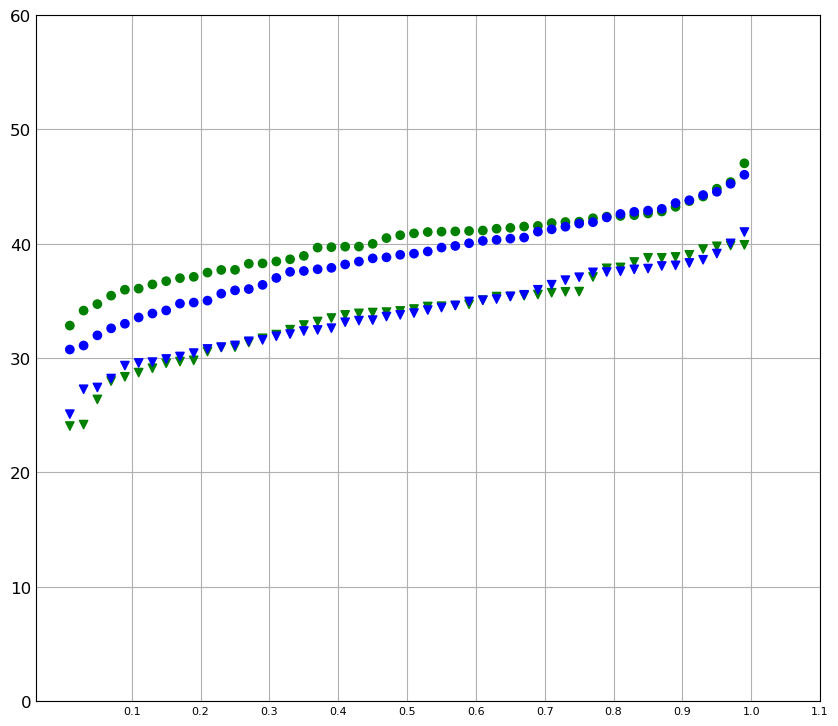

In [215]:
new_df = pd.concat([new_valid_df, new_test_df])
plot_distribution(calculate_quantiles(new_df, 0), calculate_quantiles(new_df, 1))

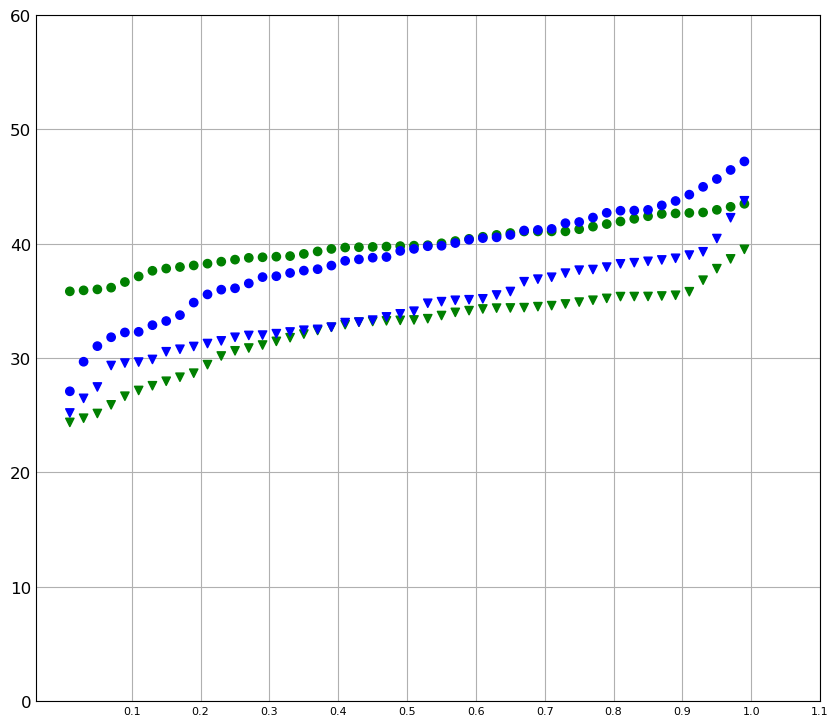

In [114]:
new_df = pd.concat([new_valid_df, new_test_df])
plot_distribution(calculate_quantiles(new_df, 0), calculate_quantiles(new_df, 1))

In [187]:
plot_distribution(calculate_quantiles(new_df, 1))

TypeError: 'NoneType' object is not subscriptable

In [1]:
from drecg.data.utils import create_dataloader_test, create_dataloader_validation

test_dl = create_dataloader_test()
valid_dl = create_dataloader_validation()

In [2]:
import pandas as pd

def basic_image_dataloader_to_dataframe(dl):
    pairs = list(dl.dataset)
    l_data = [(img_a, img_b, y) for (x, y, (img_a, img_b)) in pairs]
    return pd.DataFrame(l_data, columns=['img_a', 'img_b', 'y'])

In [3]:
test_df_to_merge = basic_image_dataloader_to_dataframe(test_dl)
valid_df_to_merge = basic_image_dataloader_to_dataframe(valid_dl)

In [4]:
len(test_df_to_merge), len(valid_df_to_merge)
#TODO: merge the two dataframes and create a new test and validation set with the same distribution and random split

(252, 250)

In [5]:
merged = pd.concat([valid_df_to_merge, test_df_to_merge])
merged

,img_a,img_b,y
0,/home/daniel/data_dogs/validation/same/1402a.png,/home/daniel/data_dogs/validation/same/1402b.png,1
1,/home/daniel/data_dogs/validation/same/1409a.png,/home/daniel/data_dogs/validation/same/1409b.png,1
2,/home/daniel/data_dogs/validation/same/1410a.png,/home/daniel/data_dogs/validation/same/1410b.png,1
3,/home/daniel/data_dogs/validation/same/1412a.png,/home/daniel/data_dogs/validation/same/1412b.png,1
4,/home/daniel/data_dogs/validation/same/1413a.png,/home/daniel/data_dogs/validation/same/1413b.png,1
...,...,...,...
247,/home/daniel/data_dogs/testing/different/2295a...,/home/daniel/data_dogs/testing/different/2295b...,0
248,/home/daniel/data_dogs/testing/different/2296a...,/home/daniel/data_dogs/testing/different/2296b...,0
249,/home/daniel/data_dogs/testing/different/2297a...,/home/daniel/data_dogs/testing/different/2297b...,0
250,/home/daniel/data_dogs/testing/different/2299a...,/home/daniel/data_dogs/testing/different/2299b...,0


In [6]:
from sklearn.model_selection import train_test_split
valid, test = train_test_split(merged, test_size=0.5, stratify=merged['y'])

In [8]:
valid

,img_a,img_b,y
29,/home/daniel/data_dogs/testing/same/167a.png,/home/daniel/data_dogs/testing/same/167b.png,1
58,/home/daniel/data_dogs/validation/same/22149a.png,/home/daniel/data_dogs/validation/same/22149b.png,1
28,/home/daniel/data_dogs/testing/same/164a.png,/home/daniel/data_dogs/testing/same/164b.png,1
151,/home/daniel/data_dogs/validation/different/16...,/home/daniel/data_dogs/validation/different/16...,0
62,/home/daniel/data_dogs/testing/same/22137a.png,/home/daniel/data_dogs/testing/same/22137b.png,1
...,...,...,...
48,/home/daniel/data_dogs/testing/same/22111a.png,/home/daniel/data_dogs/testing/same/22111b.png,1
84,/home/daniel/data_dogs/validation/same/2234a.png,/home/daniel/data_dogs/validation/same/2234b.png,1
55,/home/daniel/data_dogs/testing/same/22127a.png,/home/daniel/data_dogs/testing/same/22127b.png,1
112,/home/daniel/data_dogs/testing/same/2282a.png,/home/daniel/data_dogs/testing/same/2282b.png,1


In [10]:
import shutil
from pathlib import Path
new_root = Path('/home/daniel/data_dog_new_2/')
new_root.mkdir(exist_ok=True)
new_valid_root = new_root / 'validation'
new_valid_root.mkdir(exist_ok=True)
new_test_root = new_root / 'testing'
new_test_root.mkdir(exist_ok=True)

def copy_images_2(df, split):
    split_dir = new_valid_root if split == 'valid' else new_test_root
    (split_dir / 'same').mkdir(exist_ok=True)
    (split_dir / 'different').mkdir(exist_ok=True)
    for i in range(len(df)):
        img_path_a = df.iloc[i]['img_a']
        img_path_b = df.iloc[i]['img_b']
        same = df.iloc[i]['y'] == 1
        new_file_path = split_dir / ('same' if same else 'different')
        img_a = Path(img_path_a)
        img_b = Path(img_path_b)

        new_file_path_a = new_file_path / f'{img_a.name}'
        new_file_path_b = new_file_path / f'{img_b.name}'

        shutil.copy(img_path_a, new_file_path_a)
        shutil.copy(img_path_b, new_file_path_b)

In [12]:
copy_images_2(valid, 'valid')
copy_images_2(test, 'test')

In [3]:
params = {
    'batch_size': 64,
    'num_workers': 4,
    'pin_memory': True,
    'shuffle': True
}

for key, value in params.items():
    print(f'{key}: {value}')

batch_size: 64
num_workers: 4
pin_memory: True
shuffle: True
